# UBC OCEAN - EDA and TMA file visualization

## Installs
* Pyvips for handling large files
* Scienceplots for IEEE style plots

In [1]:
!ls /kaggle/input/pyvips-python-and-deb-package

!dpkg -i --force-depends /kaggle/input/pyvips-python-and-deb-package/linux_packages/archives/*.deb

!pip install pyvips -f /kaggle/input/pyvips-python-and-deb-package/python_packages/ --no-index
!pip list | grep pyvips


linux_packages	python_packages
Selecting previously unselected package autoconf.
(Reading database ... 107763 files and directories currently installed.)
Preparing to unpack .../autoconf_2.69-11.1_all.deb ...
Unpacking autoconf (2.69-11.1) ...
Selecting previously unselected package automake.
Preparing to unpack .../automake_1%3a1.16.1-4ubuntu6_all.deb ...
Unpacking automake (1:1.16.1-4ubuntu6) ...
Selecting previously unselected package autopoint.
Preparing to unpack .../autopoint_0.19.8.1-10build1_all.deb ...
Unpacking autopoint (0.19.8.1-10build1) ...
Selecting previously unselected package autotools-dev.
Preparing to unpack .../autotools-dev_20180224.1_all.deb ...
Unpacking autotools-dev (20180224.1) ...
Selecting previously unselected package bzip2-doc.
Preparing to unpack .../bzip2-doc_1.0.8-2_all.deb ...
Unpacking bzip2-doc (1.0.8-2) ...
Selecting previously unselected package debhelper.
Preparing to unpack .../debhelper_12.10ubuntu1_all.deb ...
Unpacking debhelper (12.10ubuntu1

In [2]:
!pip install scienceplots

## Imports

In [3]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style('darkgrid')
import plotly.express as px
from tqdm.auto import tqdm

import scienceplots
plt.style.use(['science','no-latex'])

import pyvips
pyvips.__version__

'2.2.2'

## Load Training Data

In [4]:
top_dir = '/kaggle/input/UBC-OCEAN'
train_img_dir = '/kaggle/input/UBC-OCEAN/train_images'
train_thumb_dir = '/kaggle/input/UBC-OCEAN/train_thumbnails'

train = pd.read_csv(f'{top_dir}/train.csv')
train.head()

,image_id,label,image_width,image_height,is_tma
0,4,HGSC,23785,20008,False
1,66,LGSC,48871,48195,False
2,91,HGSC,3388,3388,True
3,281,LGSC,42309,15545,False
4,286,EC,37204,30020,False


## Height/Width Distribution

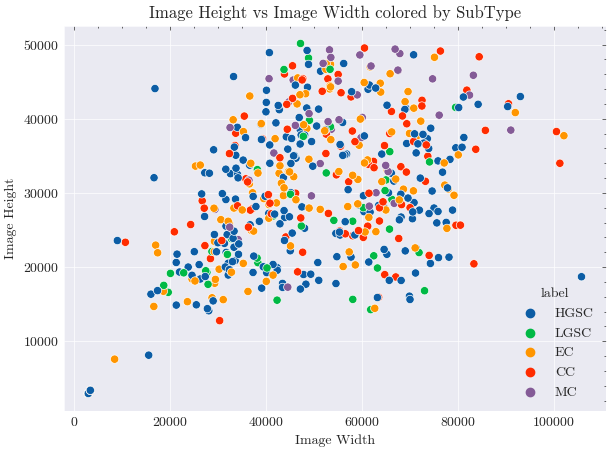

In [5]:
plt.figure(figsize=(7,5))
sns.scatterplot(x=train.image_width,y=train.image_height,hue=train.label)
plt.xlabel('Image Width')
plt.ylabel('Image Height')
plt.title('Image Height vs Image Width colored by SubType');

## Label Distribution

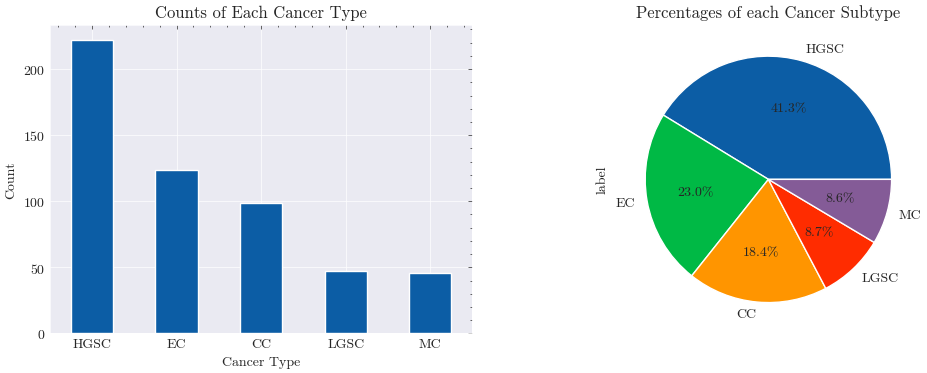

In [6]:
plt.figure(figsize=(12,4))
plt.subplot(1,2,1)
train['label'].value_counts().plot(kind='bar', xlabel='Cancer Type', ylabel='Count', rot=0)
plt.title('Counts of Each Cancer Type')
plt.subplot(1,2,2)
train['label'].value_counts().plot.pie(autopct='%1.1f%%', ylabel="label")
plt.title('Percentages of each Cancer Subtype');

## Add Path to DataFrame

In [7]:
train['image_path'] = train.image_id.apply(lambda n: f'{top_dir}/train_images/{str(n)}.png')

# Look at TMA files
* These are what most of the test data will be.
* But only have 25 to train on, see below.

In [8]:
train_tma = train[train.is_tma == True]
print(f'Number of TMA files: {len(train_tma)}')

train_tma.image_width.value_counts()
# value counts:
# 3388    14
# 2964    11

Number of TMA files: 25


image_width
3388    14
2964    11
Name: count, dtype: int64

### Takeaways
* tma files are of two sizes: 
* 2964 x 2964
* 3388 x 3388

In [9]:
train_tma.head()

,image_id,label,image_width,image_height,is_tma,image_path
2,91,HGSC,3388,3388,True,/kaggle/input/UBC-OCEAN/train_images/91.png
37,4134,MC,2964,2964,True,/kaggle/input/UBC-OCEAN/train_images/4134.png
76,8280,HGSC,2964,2964,True,/kaggle/input/UBC-OCEAN/train_images/8280.png
83,9200,MC,3388,3388,True,/kaggle/input/UBC-OCEAN/train_images/9200.png
112,13568,LGSC,2964,2964,True,/kaggle/input/UBC-OCEAN/train_images/13568.png


## Compare tma files

  0%|          | 0/25 [00:00<?, ?it/s]

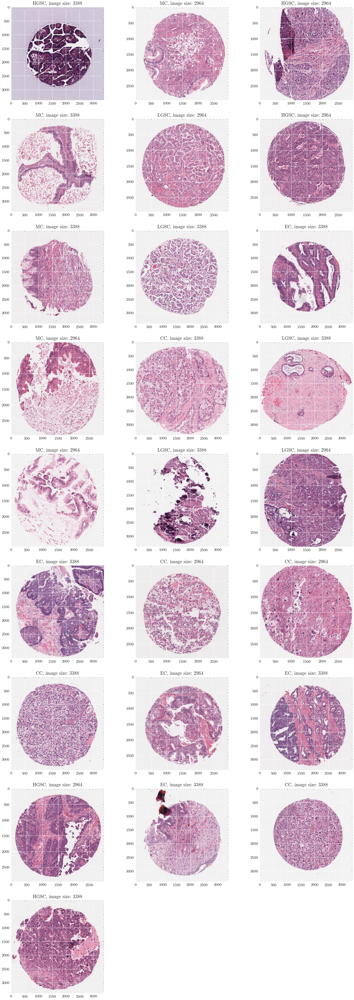

In [10]:
rows = int(np.ceil(len(train_tma)/3))
plt.figure(figsize=(16,5*rows))   #smaller starts overlapping

for i in tqdm(range(len(train_tma))):
    im = pyvips.Image.new_from_file(train_tma.iloc[i].image_path)
#     im_small = pyvips.Image.thumbnail(im, maxw, height=maxh)
#     im_small = pyvips.Image.thumbnail(train_tma.iloc[i].image_path, 512)
#     print(f'Image w x h: {im.width} x {im.height} pixels')
#     print(f'Image resolution: {im.xres} x {im.yres} px/mm')
#     print(f'Image bands: {im.bands}')
#     print(f'Image Format: {im.format}')
    plt.subplot(rows,3,i+1) 
    plt.imshow(im)
    plt.title(f'{train_tma.iloc[i].label}, image size: {im.width}')
     
# both 3388 and 2964 show 2.834x2.834 px/mm, so the circles should be subtend the same amount of pixels.  
# And if scaled to the same size, the circle in the larger image will look smaller.
# And one will just have more empty space around it.

## 5X Zoom

  0%|          | 0/25 [00:00<?, ?it/s]

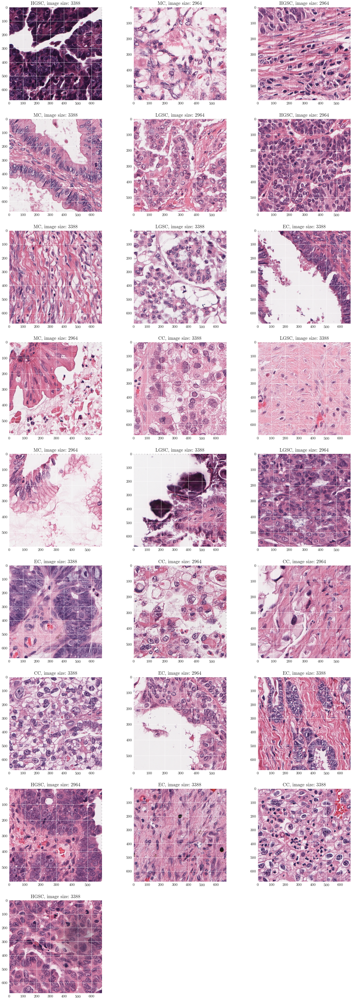

In [11]:
# look at the cropped region in the center of each image, to look for finer structure, use 1/5 to start
rows = int(np.ceil(len(train_tma)/3))
plt.figure(figsize=(16,5*rows))   #smaller starts overlapping

for i in tqdm(range(len(train_tma))):
    
    im = pyvips.Image.new_from_file(train_tma.iloc[i].image_path)
    img_dim = int(im.width/5)
    ctr = im.width/2
    offset = int(ctr - img_dim/2)  # square so use width only
    out = im.crop(offset, offset, img_dim, img_dim)

    plt.subplot(rows,3,i+1) 
    plt.imshow(out)
    plt.title(f'{train_tma.iloc[i].label}, image size: {im.width}')
     


## 10X Zoom

  0%|          | 0/25 [00:00<?, ?it/s]

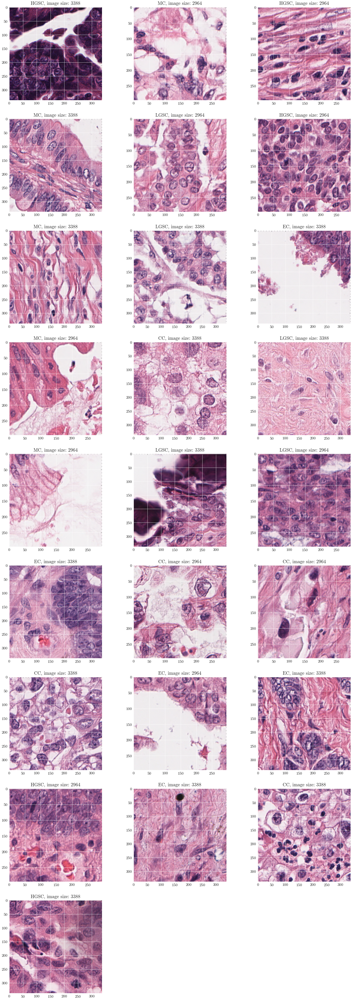

In [12]:
# look at the cropped region in the center of each image, to look for finer structure, use 1/5 to start
rows = int(np.ceil(len(train_tma)/3))
plt.figure(figsize=(16,5*rows))   #smaller starts overlapping

for i in tqdm(range(len(train_tma))):
    
    im = pyvips.Image.new_from_file(train_tma.iloc[i].image_path)
    img_dim = int(im.width/10)
    ctr = im.width/2
    offset = int(ctr - img_dim/2)  # square so use width only
    out = im.crop(offset, offset, img_dim, img_dim)

    plt.subplot(rows,3,i+1) 
    plt.imshow(out)
    plt.title(f'{train_tma.iloc[i].label}, image size: {im.width}')
     

In [13]:
print(f'ratio of sizes: {2964/3388:.2f}')

ratio of sizes: 0.87


# WSI Files
* TBD